# Probabilistic Forecasts with LightGBM

In [1]:
import pandas as pd
import numpy as np
import datetime

import plotly.express as px

import lightgbm as lgb
from mlforecast import MLForecast

from src.forecast.utils import scale_dataset

## Loading Data

In [24]:
def load_dataset(filename: str) -> pd.DataFrame:
    dataset = pd.read_parquet(filename)
    dataset = dataset.set_index("dtm")
    dataset.index = pd.to_datetime(dataset.index)
    return dataset


dataset = load_dataset("./data/final/ModellingDataset_GridDWD_2020-09-20_2024-01-30.parquet")

target = "total_generation_MWh"
dataset = dataset[
    dataset.columns[[((c.startswith("Wind")) | c.startswith("Solar") | (c == target)) for c in dataset.columns]]
]
dataset.drop(
    [
        "Solar_MW",
        "Wind_MW",
        "Solar_MW_pvlive",
        "Wind_MWh",
        "Wind_MWh_credit",
        "Solar_MWh_credit",
        "Solar_capacity_mwp",
        "Solar_installedcapacity_mwp",
        "Solar_installedcapacity_mwp_pvlive",
        "Solar_capacity_mwp_pvlive",
    ],
    axis=1,
    inplace=True,
)

### Scale the dataset

In [19]:
input_dataset = dataset[[column for column in dataset.columns if column != target]]
input_scaler, input_dataset = scale_dataset(input_dataset)
target_scaler, target_dataset = scale_dataset(dataset[[target]])
dataset = pd.concat([input_dataset, target_dataset], axis=1)
dataset = dataset.astype(np.float32)

In [21]:
dataset

,WindSpeed_100_0,WindDirection_100_0,WindHumidity_0,WindTemperature_0,WindDirection_0,WindSpeed_0,WindSpeed_100_1,WindDirection_100_1,WindHumidity_1,WindTemperature_1,...,SolarDownwardRadiation_17,SolarCloudCover_17,SolarTemperature_17,SolarDownwardRadiation_18,SolarCloudCover_18,SolarTemperature_18,SolarDownwardRadiation_19,SolarCloudCover_19,SolarTemperature_19,total_generation_MWh
dtm,,,,,,,,,,,,,,,,,,,,,
2020-09-20 23:00:00+00:00,0.173938,0.223553,0.670100,0.719704,0.221386,0.208485,0.174641,0.222627,0.661336,0.718935,...,0.000114,0.446602,0.493911,0.000000,0.293848,0.423532,0.000000,0.277852,0.433847,0.044270
2020-09-20 23:30:00+00:00,0.163922,0.231434,0.658391,0.718712,0.229273,0.197558,0.163773,0.231819,0.649130,0.718381,...,0.000005,0.266318,0.484773,0.000000,0.325879,0.419784,0.000011,0.262061,0.429704,0.038398
2020-09-21 00:00:00+00:00,0.153905,0.239314,0.646682,0.717720,0.237159,0.186630,0.152905,0.241010,0.636925,0.717827,...,0.000000,0.086035,0.475634,0.000000,0.357910,0.416037,0.000129,0.246270,0.425562,0.032291
2020-09-21 00:30:00+00:00,0.150498,0.269223,0.635979,0.720454,0.267392,0.180975,0.149229,0.267989,0.625076,0.720252,...,0.000000,0.258291,0.468269,0.000048,0.470361,0.417372,0.000000,0.310449,0.418788,0.025538
2020-09-21 01:00:00+00:00,0.147090,0.299132,0.625275,0.723188,0.297624,0.175319,0.145552,0.294967,0.613227,0.722677,...,0.000031,0.430547,0.460903,0.000118,0.582812,0.418707,0.000000,0.374629,0.412015,0.016834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-30 20:00:00+00:00,0.205177,0.837740,0.457115,0.312569,0.837078,0.242238,0.204072,0.844178,0.430294,0.312683,...,0.000130,1.000000,0.243002,0.000000,0.986973,0.223859,0.000000,0.980176,0.287200,0.047817
2024-01-30 20:30:00+00:00,0.182641,0.816192,0.432295,0.317058,0.814468,0.213780,0.181281,0.822236,0.407618,0.315736,...,0.000031,0.711553,0.232527,0.000000,0.990361,0.211941,0.000000,0.990088,0.271509,0.035131
2024-01-30 21:00:00+00:00,0.160106,0.794644,0.407475,0.321547,0.791859,0.185322,0.158490,0.800295,0.384941,0.318788,...,0.000000,0.423105,0.222052,0.000000,0.993750,0.200022,0.000000,1.000000,0.255818,0.051520


### Reindex

In [5]:
dataset = dataset[: dataset.index.max().replace(hour=22, minute=30, second=0)]
new_index = pd.date_range(dataset.index[0], end=dataset.index[-1] + datetime.timedelta(minutes=30), freq="30min")
dataset = dataset.reset_index().drop_duplicates("dtm", ignore_index=True)
dataset = dataset.set_index("dtm").reindex(new_index).ffill()
dataset.index = dataset.index.tz_localize(None)
dataset.reset_index(drop=False, inplace=True)
# dataset = dataset.resample("30min").mean()

### Split

In [6]:
Y_df = (
    dataset.reset_index()
    .melt(
        id_vars=list(dataset.columns[:-1]),
        value_vars=[target],
        var_name="unique_id",
    )
    .rename(columns={"index": "ds", "value": "y"})
)

In [7]:
horizon = 48
Y_test_df = Y_df.groupby("unique_id").tail(horizon * 365)
Y_train_df = Y_df.drop(Y_test_df.index)

In [8]:
Y_train_df.columns = Y_train_df.columns.str.replace(":", "_")
Y_test_df.columns = Y_test_df.columns.str.replace(":", "_")

## Model Training

In [10]:
lgb_params = {
    "verbosity": 0,
    # "num_leaves": 512,
    # "boosting_type":'gbdt',
    "n_estimators": 100,
    "learning_rate": 0.05,
    # 'colsample_bytree': 0.9,
    # 'colsample_bynode': 0.6,
    # "lambda_l1": 3.5,
    # "lambda_l2": 1.5,
    "max_depth": 15,
}
quantile_seq = list(np.linspace(0.1, 0.9, 9).round(2))


fcst = MLForecast(
    models={f"q{int(q*100)}": lgb.LGBMRegressor(**lgb_params, objective="quantile", alpha=q) for q in quantile_seq},
    freq="30min",
    target_transforms=[],
    lags=[],
    lag_transforms={},
    date_features=["dayofweek", "month", "hour", "minute"],  # , "year"],
)

fcst.fit(Y_train_df, static_features=[])  # , max_horizon=48) # max_horizon - individual model per time step

preds = fcst.predict(horizon * 365, X_df=Y_test_df)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

MLForecast(models=[q10, q20, q30, q40, q50, q60, q70, q80, q90], freq=30min, lag_features=[], date_features=['dayofweek', 'month', 'hour', 'minute'], num_threads=1)

In [2]:
import os
import pickle
from pathlib import Path

model_path = Path("./models/lgbm")

if not os.path.isdir(model_path):
    os.mkdir(model_path)

fcst.save(model_path)

with open(model_path / "target_scaler.pickle", "wb") as handle:
    pickle.dump(target_scaler, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open(model_path / "input_scaler.pickle", "wb") as handle:
    pickle.dump(input_scaler, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [3]:
model = MLForecast.load(path=model_path)

In [14]:
# y_test = Y_test_df.reset_index().set_index('ds').copy()

# preds = []
# for date in pd.date_range(pd.to_datetime(Y_test_df.ds.values[0]), pd.to_datetime(Y_test_df.ds.values[-1])):
#   start = date
#   end = date + datetime.timedelta(hours=23, minutes=30)
#   test = y_test.loc[start.strftime('%Y-%m-%d %H:%M:%S'): end.strftime('%Y-%m-%d %H:%M:%S')].copy()
#   test = test.reset_index().drop(["y"], axis=1)
#   old_index = test.ds.copy()
#   test.loc[:,"ds"] = Y_hat_df.loc[: , 'ds'].values
#   pred = fcst.predict(horizon, futr_df=test)
#   pred.loc[:,"ds"] = old_index.values
#   preds.append(pred)

In [15]:
df = Y_test_df[["ds", "y"]].merge(preds, on="ds").drop("unique_id", axis=1)
px.line(df, x="ds", y=df.columns[1:])

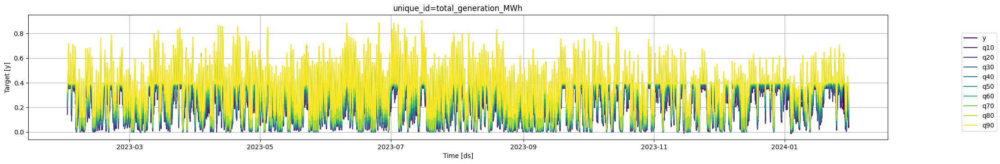

In [18]:
from utilsforecast.plotting import plot_series

fig = plot_series(Y_test_df, preds, max_insample_length=48 * 3)
fig

### Cross-validation

In [ ]:
cv_result = fcst.cross_validation(
    Y_train_df,
    n_windows=1,  # number of models to train/splits to perform
    h=horizon * 360,  # length of the validation set in each window
    static_features=[],
    # max_horizon=48
)
cv_result

,unique_id,ds,cutoff,y,q10,q20,q30,q40,q50,q60,q70,q80,q90
0,total_generation_MWh,2023-01-18 23:00:00,2023-01-18 22:30:00,591.432,554.367847,553.486221,561.678225,572.474030,572.239077,563.823907,574.391582,575.149518,587.640300
1,total_generation_MWh,2023-01-18 23:30:00,2023-01-18 22:30:00,591.432,557.488682,547.257234,552.383671,568.991993,566.748085,543.525589,573.158773,574.034107,590.636851
2,total_generation_MWh,2023-01-19 00:00:00,2023-01-18 22:30:00,590.582,544.981106,542.873840,546.994992,543.539734,525.169630,521.651054,536.004939,571.652890,574.377260
3,total_generation_MWh,2023-01-19 00:30:00,2023-01-18 22:30:00,591.402,547.466927,544.799739,553.994151,552.425226,530.351211,531.313308,540.784005,573.621871,569.058237
4,total_generation_MWh,2023-01-19 01:00:00,2023-01-18 22:30:00,591.412,549.817695,549.892924,550.559477,555.079754,531.838813,534.599012,545.045125,573.635339,567.395037
...,...,...,...,...,...,...,...,...,...,...,...,...,...
17275,total_generation_MWh,2024-01-13 20:30:00,2023-01-18 22:30:00,401.280,308.142671,312.115965,373.461451,340.852603,353.720925,391.018159,403.667141,450.814005,501.060474
17276,total_generation_MWh,2024-01-13 21:00:00,2023-01-18 22:30:00,398.210,289.285564,279.175859,374.034746,347.023543,356.614734,393.538937,412.124111,454.843712,502.788301
17277,total_generation_MWh,2024-01-13 21:30:00,2023-01-18 22:30:00,387.440,301.070226,307.230115,310.732758,298.166009,342.425450,370.197059,399.972393,448.345867,492.055539
17278,total_generation_MWh,2024-01-13 22:00:00,2023-01-18 22:30:00,351.040,300.682736,325.382638,311.069840,311.917106,372.634831,387.117151,416.743425,449.727088,481.173197


In [ ]:
px.line(cv_result, x="ds", y=cv_result.columns[3:])

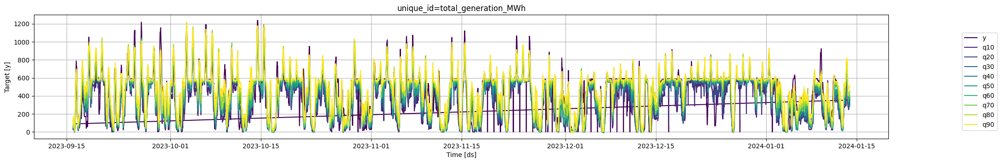

In [ ]:
fig = plot_series(cv_result, cv_result.drop(columns="cutoff"), max_insample_length=48 * 3)
fig